In [1]:
import numpy as np
from scipy.signal import spectrogram
from  audio_manager import *
import matplotlib.pyplot as plt
import hashlib
import importlib

In [17]:
# importlib.reload()
source = 'audio/20210129_pmoney_pmpod1060_2.mp3'
channels,audiofile = load_to_raw(source)
testfile = audiofile[150000:179500]

In [18]:

adfile = audiofile[162000:179500]
channels = get_channels(adfile)

In [11]:
audiofile

In [12]:
rate = audiofile.frame_rate
FFT_WID = 4096
FFT_WINDOW_OVERLAP_FRAC = 0.5
FFT_WINDOW_OVERLAP = np.floor(FFT_WID * FFT_WINDOW_OVERLAP_FRAC) #we want 12.5% overlap between spectrogram samples ? 

#okay, so number of segments = channels[0].size / (Fingerprint_wid * fingerprint_overlap)
#each spectrogram is computed over a window of 4096 samples, which works out to 4096/44100 s = 0.09 s

freqs,times,spec =  spectrogram(np.array(channels),rate,nperseg=FFT_WID,noverlap=FFT_WINDOW_OVERLAP)
#it would be nice to convert the spectrogram into decibels:
specDB = 10*np.log10(spec,out=np.zeros_like(spec),where = (spec>1))
peaks = find_peaks(specDB[0])

In [13]:
print('times: ' ,times.shape,times)
print('frequencies: ' ,freqs.shape,freqs)
channels[0].size / 44100
print('Spectrum shape: ', spec[0].shape)
print('Channel size / (wid * overlap) ',channels[0].size / ((1-FFT_WINDOW_OVERLAP_FRAC)*FFT_WID))

times:  (375,) [ 0.04643991  0.09287982  0.13931973  0.18575964  0.23219955  0.27863946
  0.32507937  0.37151927  0.41795918  0.46439909  0.510839    0.55727891
  0.60371882  0.65015873  0.69659864  0.74303855  0.78947846  0.83591837
  0.88235828  0.92879819  0.9752381   1.021678    1.06811791  1.11455782
  1.16099773  1.20743764  1.25387755  1.30031746  1.34675737  1.39319728
  1.43963719  1.4860771   1.53251701  1.57895692  1.62539683  1.67183673
  1.71827664  1.76471655  1.81115646  1.85759637  1.90403628  1.95047619
  1.9969161   2.04335601  2.08979592  2.13623583  2.18267574  2.22911565
  2.27555556  2.32199546  2.36843537  2.41487528  2.46131519  2.5077551
  2.55419501  2.60063492  2.64707483  2.69351474  2.73995465  2.78639456
  2.83283447  2.87927438  2.92571429  2.9721542   3.0185941   3.06503401
  3.11147392  3.15791383  3.20435374  3.25079365  3.29723356  3.34367347
  3.39011338  3.43655329  3.4829932   3.52943311  3.57587302  3.62231293
  3.66875283  3.71519274  3.76163265 

In [62]:
print((np.min(spec[0][spec[0]>0])))
print(spec[0][1900,12000])

3.7117868e-16
2.1984465e-06


<ipython-input-14-d53e65b6e2b8>:2: RuntimeWarning: divide by zero encountered in log
  ax.imshow(np.log(spec[0][:800]))


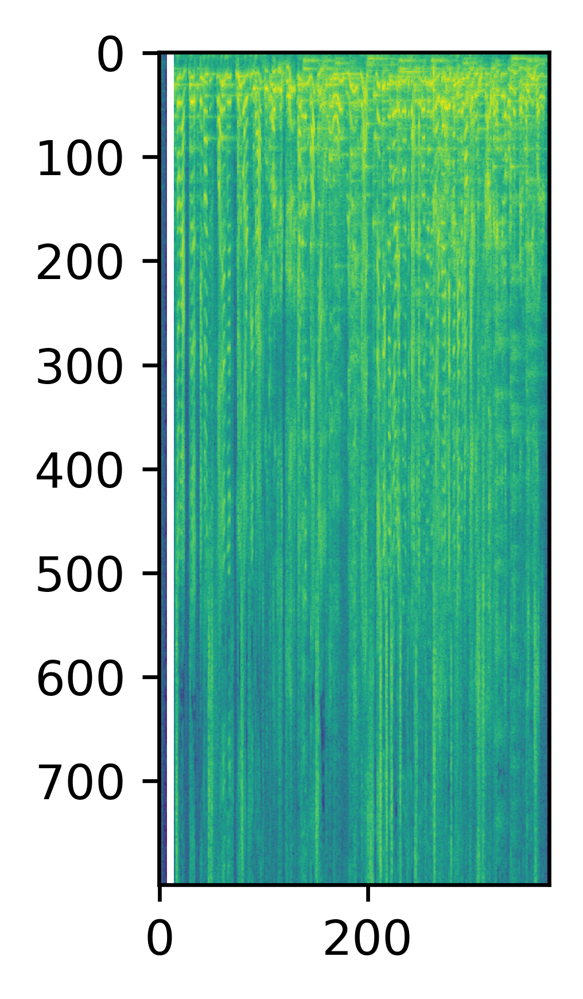

In [14]:
fig,ax = plt.subplots(1,dpi = 600, figsize = [6.4,3.2])
ax.imshow(np.log(spec[0][:800]))
plt.show()

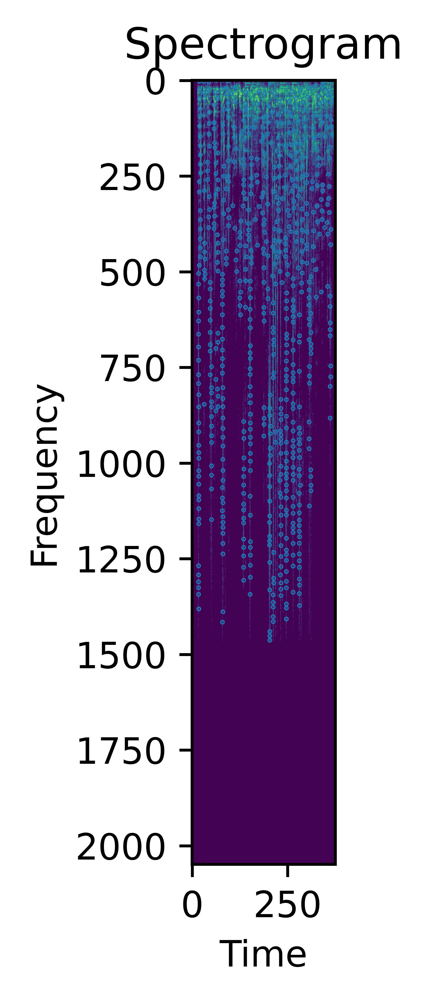

In [21]:
from scipy.ndimage.filters import maximum_filter
from scipy.ndimage.morphology import (binary_erosion,
                                      generate_binary_structure,
                                      iterate_structure)

specDB_img = specDB[0]
#let's find ourselves a peak!
struct = generate_binary_structure(2, 2) #dimension, taxicab distance.

#  And then we apply dilation using the following function
#  http://docs.scipy.org/doc/scipy/reference/generated/scipy.ndimage.iterate_structure.html
#  Take into account that if PEAK_NEIGHBORHOOD_SIZE is 2 you can avoid the use of the scipy functions and just
#  change it by the following code:
#  neighborhood = np.ones((PEAK_NEIGHBORHOOD_SIZE * 2 + 1, PEAK_NEIGHBORHOOD_SIZE * 2 + 1), dtype=bool)
neighborhood = iterate_structure(struct, 10)

# find local maxima using our filter mask
local_max = maximum_filter(specDB_img, footprint=neighborhood) == specDB_img

# Applying erosion, the dejavu documentation does not talk about this step.
background = (specDB_img == 0)
eroded_background = binary_erosion(background, structure=neighborhood, border_value=1)

# Boolean mask of specDB_img with True at peaks (applying XOR on both matrices).
detected_peaks = local_max != eroded_background

# extract peaks
amps = specDB_img[detected_peaks]
freqInds, timeInds = np.where(detected_peaks)

# filter peaks
amps = amps.flatten()

# get indices for frequency and time
filter_idxs = np.where(amps > 15)

freqs_filter = freqInds[filter_idxs]
times_filter = timeInds[filter_idxs]

#okay let's sort based on ascending time, rather than ascending frequency? 
times_filter,freqs_filter = zip(*sorted(zip(times_filter,freqs_filter)))

if True:
    # scatter of the peaks
    fig, ax = plt.subplots(dpi=1000)
    ax.imshow(specDB_img,origin='lower')
    ax.scatter(times_filter, freqs_filter, s = 0.1)
    ax.set_xlabel('Time')
    ax.set_ylabel('Frequency')
    ax.set_title("Spectrogram")
    ax.invert_yaxis()
    plt.show()

In [13]:

# peaks = list(zip(times_filter,freqs_filter))
rng = np.random.RandomState(1337)


#let's take in the peaks, and output the corresponding hashes 
#assume sorted by time.
hashes = []

#let's use each peak at least once
#and try it with a few other neighbouring peaks (randomly selected from the future 10 peaks ?) 

maxind = np.shape(peaks)[0]-1
for i,peak in enumerate(peaks): 
    if(maxind - i < 8): 
        break
    allowed_inds= np.arange( i+1, np.min([i+6,maxind])  )
    other_peaks = np.sort(rng.choice(allowed_inds,np.min([5,maxind-i]),False))
    t0 = peak[0]
    str = '%d,%d'%(t0,peak[1])
    for op_ind in other_peaks:
        op = peaks[op_ind]
        str+='|%d,%d'%(op[0]-t0,op[1])
#     print(str)
    h =  hashlib.sha1(str.encode('utf-8'))
    hash = (h.hexdigest(),t0)    
    hashes.append(hash)

In [38]:
#Planet money 01292021
#2:42 to 3:20

In [17]:
hashes

[('0a1402dc512b9c2a92f9cf30808afc00e3c61cd3', 504),
 ('7dfc6b02bbd08a9993718ced0438279b657d6979', 532),
 ('6978cb7a20ef8123bfb6157260bfe807aaa0294c', 696),
 ('01b0f5623cd00c25d347a195188a40dc26c021cf', 731),
 ('43179176d7b96cc63ba7b876cf2743bf5ff91d71', 769),
 ('87725b4014b74e1653441f43444245aac11eabff', 1192),
 ('c1b3f2f33205df1b0720f4105262fb1b23e9d6ac', 1268),
 ('9b6a9ee316cfa5ba2c25e5478e9c1e8763444acb', 1292),
 ('0c1388f845f143b1c8f8c22cb9ad53a82ba021bf', 1310),
 ('84164fc83c7dd8ecc5cb129faf710be5abb27958', 1343),
 ('a17a5f7085ac9f3ed6047f9f0551327629ce98ea', 568),
 ('b58de6028053c29cc5a8456cd5bf7adae5fb2762', 605),
 ('681972b13e0f23b2f0adb8514364fab07ad81e47', 821),
 ('cde2a7e13c881cf7eeab3e866d0cfde7d694c36d', 853),
 ('d6946341c5a4da82c0b98418b8f7b12e44e5f2fd', 895),
 ('c6ce0274ac0de145d1929b86f161a9ca7704f650', 918),
 ('3fb06382c8310ab2e1376b0491c2a1097fcd552a', 953),
 ('1801026842c6f2b2a9c276426ca9bce38843982f', 972),
 ('298c0dede6d95b667ace063fc1b949f3d271343c', 1034),
 ('f83

In [12]:
times_filter

NameError: name 'times_filter' is not defined

In [16]:
ad_hashes = fingerprint(adfile)

0 504 (504, 16)
1 532 (532, 16)
2 628 (628, 16)
3 663 (663, 16)
4 696 (696, 16)
5 731 (731, 16)
6 769 (769, 16)
7 792 (792, 16)
8 1192 (1192, 16)
9 1268 (1268, 16)
10 1292 (1292, 16)
11 1310 (1310, 16)
12 1325 (1325, 16)
13 1343 (1343, 16)
14 568 (568, 17)
15 605 (605, 17)
16 821 (821, 17)
17 853 (853, 17)
18 895 (895, 17)
19 918 (918, 17)
20 953 (953, 17)
21 972 (972, 17)
22 987 (987, 17)
23 1020 (1020, 17)
24 1034 (1034, 17)
25 1055 (1055, 17)
26 1085 (1085, 17)
27 1096 (1096, 17)
28 1119 (1119, 17)
29 1146 (1146, 17)
30 1158 (1158, 17)
31 1381 (1381, 17)
32 1409 (1409, 17)
33 2 (2, 18)
34 24 (24, 18)
35 48 (48, 18)
36 264 (264, 18)
37 291 (291, 18)
38 483 (483, 18)
39 119 (119, 19)
40 73 (73, 21)
41 146 (146, 21)
42 171 (171, 21)
43 194 (194, 21)
44 219 (219, 21)
45 340 (340, 21)
46 364 (364, 21)
47 388 (388, 21)
48 413 (413, 21)
49 437 (437, 21)
50 461 (461, 21)
51 91 (91, 22)
52 241 (241, 22)
53 2 (2, 30)
54 31 (31, 30)
55 540 (540, 30)
56 288 (288, 31)
57 846 (846, 31)
58 899 (89

532 1379 (1379, 246)
533 1407 (1407, 246)
534 1429 (1429, 246)
535 1444 (1444, 246)
536 555 (555, 247)
537 576 (576, 247)
538 622 (622, 247)
539 663 (663, 247)
540 674 (674, 247)
541 691 (691, 247)
542 711 (711, 247)
543 482 (482, 249)
544 339 (339, 250)
545 506 (506, 250)
546 109 (109, 253)
547 54 (54, 254)
548 82 (82, 254)
549 136 (136, 254)
550 353 (353, 254)
551 381 (381, 254)
552 224 (224, 257)
553 394 (394, 257)
554 168 (168, 258)
555 196 (196, 258)
556 93 (93, 259)
557 29 (29, 261)
558 260 (260, 261)
559 289 (289, 261)
560 518 (518, 264)
561 536 (536, 264)
562 574 (574, 264)
563 591 (591, 264)
564 602 (602, 264)
565 617 (617, 264)
566 631 (631, 264)
567 678 (678, 264)
568 705 (705, 264)
569 742 (742, 264)
570 763 (763, 264)
571 776 (776, 264)
572 787 (787, 264)
573 817 (817, 264)
574 845 (845, 264)
575 857 (857, 264)
576 893 (893, 264)
577 915 (915, 264)
578 941 (941, 264)
579 956 (956, 264)
580 972 (972, 264)
581 985 (985, 264)
582 1011 (1011, 264)
583 1029 (1029, 264)
584 1045

In [20]:
source_hashes = fingerprint(testfile)

0 109 (109, 2)
1 237 (237, 2)
2 436 (436, 2)
3 484 (484, 2)
4 733 (733, 5)
5 459 (459, 6)
6 515 (515, 6)
7 634 (634, 6)
8 702 (702, 6)
9 747 (747, 6)
10 823 (823, 6)
11 834 (834, 6)
12 874 (874, 6)
13 1035 (1035, 6)
14 1059 (1059, 6)
15 1139 (1139, 6)
16 1238 (1238, 6)
17 386 (386, 7)
18 399 (399, 7)
19 472 (472, 7)
20 649 (649, 7)
21 667 (667, 7)
22 678 (678, 7)
23 921 (921, 7)
24 948 (948, 7)
25 967 (967, 7)
26 1074 (1074, 7)
27 1172 (1172, 7)
28 1202 (1202, 7)
29 1290 (1290, 7)
30 1302 (1302, 7)
31 1335 (1335, 7)
32 1451 (1451, 7)
33 1464 (1464, 7)
34 129 (129, 8)
35 366 (366, 8)
36 424 (424, 8)
37 18 (18, 9)
38 37 (37, 9)
39 55 (55, 9)
40 147 (147, 9)
41 165 (165, 9)
42 203 (203, 9)
43 222 (222, 9)
44 258 (258, 9)
45 276 (276, 9)
46 295 (295, 9)
47 314 (314, 9)
48 332 (332, 9)
49 350 (350, 9)
50 497 (497, 9)
51 82 (82, 13)
52 773 (773, 17)
53 864 (864, 17)
54 885 (885, 17)
55 936 (936, 17)
56 983 (983, 17)
57 1000 (1000, 17)
58 1012 (1012, 17)
59 1027 (1027, 17)
60 1046 (1046, 17)


559 82 (82, 182)
560 245 (245, 182)
561 490 (490, 182)
562 164 (164, 184)
563 327 (327, 185)
564 409 (409, 185)
565 572 (572, 185)
566 421 (421, 188)
567 356 (356, 189)
568 65 (65, 190)
569 130 (130, 190)
570 454 (454, 190)
571 519 (519, 190)
572 587 (587, 190)
573 984 (984, 190)
574 1000 (1000, 190)
575 1012 (1012, 190)
576 27 (27, 193)
577 273 (273, 193)
578 292 (292, 196)
579 259 (259, 198)
580 389 (389, 199)
581 655 (655, 200)
582 109 (109, 201)
583 436 (436, 201)
584 545 (545, 201)
585 327 (327, 202)
586 195 (195, 206)
587 454 (454, 206)
588 65 (65, 207)
589 41 (41, 209)
590 409 (409, 211)
591 82 (82, 212)
592 245 (245, 212)
593 490 (490, 212)
594 130 (130, 217)
595 389 (389, 217)
596 275 (275, 220)
597 459 (459, 220)
598 109 (109, 222)
599 327 (327, 223)
600 36 (36, 225)
601 218 (218, 231)
602 436 (436, 231)
603 65 (65, 233)
604 30 (30, 274)
605 505 (505, 275)
606 532 (532, 275)
607 543 (543, 275)
608 568 (568, 275)
609 602 (602, 275)
610 625 (625, 275)
611 638 (638, 275)
612 663

1044 1314 (1314, 471)
1045 1344 (1344, 471)
1046 1384 (1384, 471)
1047 1401 (1401, 471)
1048 1414 (1414, 471)
1049 388 (388, 473)
1050 32 (32, 474)
1051 226 (226, 474)
1052 256 (256, 474)
1053 290 (290, 474)
1054 417 (417, 474)
1055 447 (447, 474)
1056 479 (479, 474)
1057 565 (565, 477)
1058 918 (918, 477)
1059 945 (945, 477)
1060 183 (183, 479)
1061 308 (308, 480)
1062 369 (369, 480)
1063 461 (461, 480)
1064 109 (109, 481)
1065 148 (148, 483)
1066 87 (87, 484)
1067 321 (321, 484)
1068 340 (340, 485)
1069 168 (168, 486)
1070 196 (196, 486)
1071 223 (223, 486)
1072 392 (392, 486)
1073 420 (420, 486)
1074 448 (448, 486)
1075 499 (499, 489)
1076 1079 (1079, 489)
1077 580 (580, 490)
1078 685 (685, 490)
1079 856 (856, 490)
1080 871 (871, 490)
1081 887 (887, 490)
1082 915 (915, 490)
1083 926 (926, 490)
1084 937 (937, 490)
1085 948 (948, 490)
1086 976 (976, 490)
1087 1008 (1008, 490)
1088 1029 (1029, 490)
1089 1114 (1114, 490)
1090 1138 (1138, 490)
1091 1163 (1163, 490)
1092 1186 (1186, 490)


In [13]:
hits = 0
for i,srchash in enumerate(source_hashes):
    for j,adhash in enumerate(ad_hashes):
        if(srchash[0] == adhash[0]):
            hits+=1

In [14]:
print(hits)

0


In [8]:
srchash[0]

'312c0474d7cdfd01dd813c33ddd1d68799012cef'

In [9]:
adhash[0]

'50dc1ed014b10a8ec0e6cc68db7f4f6bba129472'

In [18]:
print(source_hashes)

[('873d7e22f3940da9fbf9f7ef17bb85ddc7e3fd65', 109), ('e22e25427c1fcd483439033e55e6b965bd55a82b', 436), ('1b7c564eb7b8f8f9e0bc121d95ec82a77ca540d3', 733), ('c112ad2cd87de79c69736d3dd7bfd3e8283160bd', 515), ('2f38a37146877d0480f4524a2f6b51ad904f55e3', 1059), ('bbd648c7d4f0d71b7aa93ff920178dd3bc4adc27', 967), ('be6531776c601fc3cfc969378dae111028239380', 1202), ('a7ed2ca1603e71794550bff988236260a243149e', 1302), ('2050eb565d3ef20e754fd4bf7eecac056974a97c', 1451), ('90b33b1fdb8f88e5ac6a61355761662d6049bd42', 165), ('91194a31bb66264d37f8b94583db289863d38c25', 203), ('1a133e17635449e093b2e7a871561591b553acaa', 222), ('634cdc74fe128a21bd55b81a82525c7a632d97e4', 773), ('19632ac17e61941b0dda0ca211aa8c24685590d7', 885), ('05c2dc13610035c8621c83f3b309669c743efea6', 1012), ('3217be475c28b2dd5f06f92d15190d16a18a4063', 1091), ('75108bb8e15dc0160e4ff24ae606dcf63301eadb', 1138), ('ca75acc1401ecdca26efa80c5a6568b4db17b4f9', 1371), ('5a8ddfe5ff8befcd715929c3f8fe9b18d3f9efa1', 1398), ('2e83628471a7fc5edd3

In [17]:
print(ad_hashes)

[('1267c3c494ca1e6aa4ddc96177d215f4221527a9', 504), ('b51627affa5dd217ff9c57d99358fd4aec9d2ed9', 532), ('e3af06216a7e14c56169e359a1d2474f79a9d9ea', 696), ('2649e636fcbd18cd52d0d181b563f46950583ff3', 731), ('b2f4730159440a5bb05dffee398ce9c1c35cd86c', 769), ('e4a866a56554ab3b1853b15bd02f66e80284555e', 1192), ('d2bf75b1ccb8389aa9bbed2a0cf535ffe862cc25', 1268), ('478870029593f30afcffd5824f6614a5c833db95', 1292), ('c9bf5a692a4e464bb3ad46d0d9df4a81d21ea3bf', 1310), ('cf5516351d5c87d40bbac831b82e5a2215fae490', 1343), ('8a99992ffad9f30a3109022ae4c3e71123cf573c', 568), ('9865068286a6d35b5a14005f084dea09cbdcf67b', 605), ('1f9f34a955cfb0a8b023c13597cd2bb518aedd44', 821), ('684e2afe1b97f32e4878478bc1be6a2d4ca8954d', 853), ('a177256b65366984ad1eb79f44c0b45bb64a866f', 895), ('7173d80a6234b79e60be8a14dbfc302d2d60c2e0', 918), ('bdf737a935c23294ff2a40678902a130595d0cdb', 953), ('7dd9375bc073dc4e7f15b70d27d1ee0b72a60136', 972), ('c6be7cc9c2c32036bba3a464c3e43dec78fb00b9', 1034), ('0e9aa33c00f0b1fd9d4465